In [1]:
# version corrected by AI because it didn't upload the image on fourth cell, line add by me, Bruno.

# Célula 1: Importação das Bibliotecas Necessárias
# Importa as bibliotecas necessárias para interagir com o Gemini, exibir imagens e manipular arquivos.
import google.generativeai as genai
from IPython.display import display
from PIL import Image
import io
from google.colab import files
from google.colab import userdata  # Importa a funcionalidade userdata



In [2]:

# Célula 2: Carregamento da Chave de API do Google Colab Secrets
# Carrega a chave de API armazenada nos Segredos do Colab.
try:
    GOOGLE_API_KEY = userdata.get('GOOGLE_API_KEY')  # Use o nome que você deu ao segredo, coloque sua chave somente na função get!
    if not GOOGLE_API_KEY:
        raise ValueError("Chave de API do Gemini não encontrada nos Segredos do Colab.")
    genai.configure(api_key=GOOGLE_API_KEY)
    print("Chave de API carregada com sucesso dos Segredos do Colab.")
except ValueError as e:
    print(f"Erro ao carregar a chave de API: {e}")
    print("Certifique-se de ter adicionado um segredo com o nome 'GEMINI_API_KEY' na seção 'Segredos' do Colab.")
    exit()


Chave de API carregada com sucesso dos Segredos do Colab.


In [3]:

# Célula 3: Seleção do Modelo Gemini para Visão
# Seleciona o modelo Gemini Pro Vision, que é capaz de processar tanto texto quanto imagens.
try:
    # model = genai.GenerativeModel('gemini-1.5-flash-001') # funcionou
    model = genai.GenerativeModel('gemini-2.0-flash') # funcionou, ambos funcionarão nos testes, use o que preferir!

except AttributeError as e:
    print(f"Erro ao inicializar o modelo: {e}")
    print("Certifique-se de que a biblioteca google.generativeai está instalada corretamente e atualizada.")
    print("Tente executar:\n!pip install -U google-generativeai")
    import pkg_resources
    try:
        version = pkg_resources.get_distribution("google-generativeai").version
        print(f"Versão da biblioteca google.generativeai: {version}")
    except pkg_resources.DistributionNotFound:
        print("A biblioteca google.generativeai não foi encontrada.")
    exit()


In [4]:


# Célula 4: Função para Carregar e Exibir a Imagem
# Define uma função para permitir que o usuário carregue uma imagem e a exiba no Colab.
def carregar_e_exibir_imagem():
    uploaded = files.upload()
    if not uploaded:
        print("Nenhuma imagem foi carregada.")
        return None, None
    nome_arquivo = list(uploaded.keys())[0]
    imagem_bytes = uploaded[nome_arquivo]
    imagem = Image.open(io.BytesIO(imagem_bytes))
    display(imagem)
    return imagem, imagem_bytes



Saving IMG_20250517_092342651_HDR.jpg to IMG_20250517_092342651_HDR.jpg


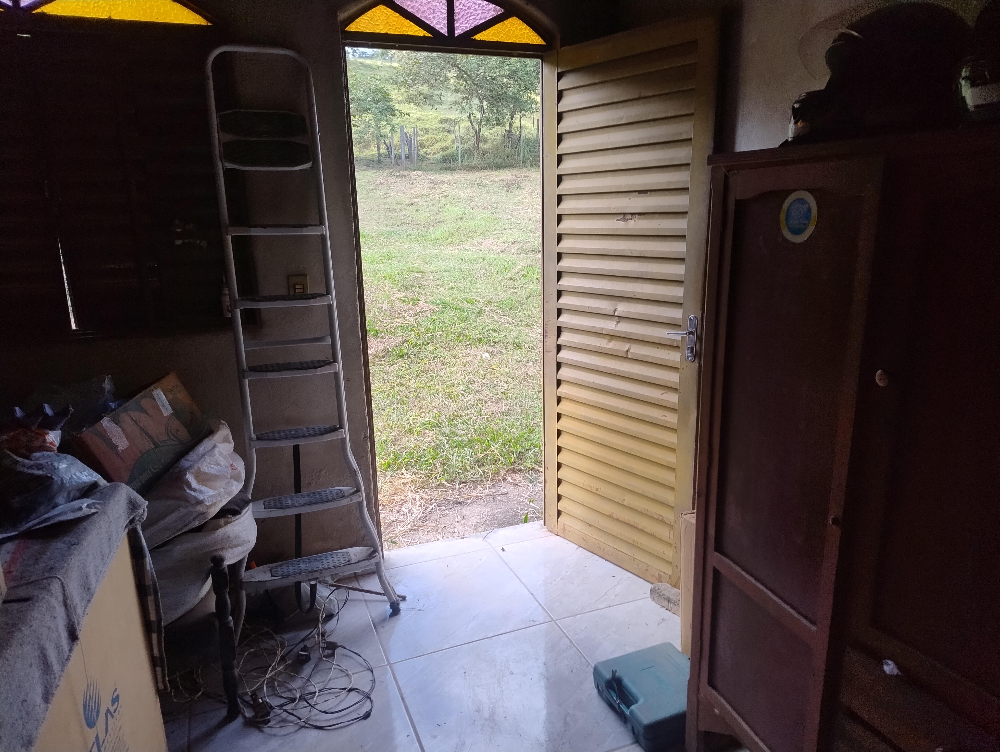

In [5]:
# Célula 5: Carregar a Imagem, A imagem está no git para testar, ou pode usar uma de sua preferência!!
# Chama a função para carregar a imagem que você deseja processar.
imagem_pil, imagem_bytes = carregar_e_exibir_imagem()

# Verifica se a imagem foi carregada corretamente.
if imagem_pil is None:
    exit()


In [6]:
# Agora será feita a avaliação da imagem pra que me diga o que há de objetos na imagem! Assim, o usuário saberia como se locomover!
# Outro ponto é que a saída está em texto, mas na versão funcional seria em áudio para o usuário com deficiência visual, por exemplo!
# Célula 6: Consulta ao Modelo Gemini para Análise da Imagem
# Esta célula formula a pergunta para o modelo Gemini, incluindo a imagem carregada.
# O prompt pede para identificar os objetos e suas posições relativas ao observador.
prompt = "Analise esta imagem e descreva os objetos presentes, indicando suas posições relativas ao observador (quem tirou a foto). Use termos como 'à esquerda', 'à direita', 'ao centro', 'mais à frente', 'mais ao fundo', e estimando distâncias aproximadas se possível (ex: 'a cerca de 1 metro à direita'). Seja conciso e informativo."

# Verifica se a imagem foi carregada corretamente.
if imagem_pil is not None:
    # Envia o prompt e a imagem para o modelo Gemini para gerar uma resposta.
    # Passando o objeto PIL em vez dos bytes.
    response = model.generate_content([prompt, imagem_pil])
    # Imprime o resultado da análise da imagem.
    print("\nResultado da análise da imagem:")
    print(response.text)
else:
    # Imprime uma mensagem se nenhuma imagem estiver disponível para análise.
    print("Nenhuma imagem para analisar.")



Resultado da análise da imagem:
A partir do ponto de vista do observador:

*   **À esquerda:** Uma escada de alumínio encostada na parede, com objetos diversos (caixas e sacos) amontoados à sua base.
*   **Ao centro:** Uma porta de madeira, parcialmente aberta, que dá para uma área externa com grama e vegetação.
*   **À direita:** Um guarda-roupa de madeira escura.
*   **Mais ao fundo:** Através da porta, vê-se um campo com grama, árvores e uma cerca.
*   **Mais à frente:** No chão, perto da porta e à direita, há uma caixa de ferramentas azul.


Cooreta devolução dos dados! Isso abre o caminho para desenvolver essa ideia e aperfeiçoa-la em apps e modelos mais adequados para processar os dados em tempo real, sem perda de tempo em feedback para o usuário, considerando que ele dependeria dessa informação em áudio para se locomover!

Bom, pessoal, a ideia é essa! OBrigado por seu tempo, conto com seu voto se achar a ideia bacana e útil!

bye, bye, for now!
desculpe, por não ter áudio, não deu pra gravar! Sorry!